In [1]:
import os 

if os.path.basename(os.getcwd()) == "notebooks":
    os.chdir("..")

In [2]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import dates as mdates
import plotly.io as pio
import datetime
import datajoint 

In [3]:
from workflow.pipeline import culture, ephys, mua, analysis

[2025-06-25 17:50:42,198][INFO]: Connecting judewerth@db.datajoint.com:3306
[2025-06-25 17:50:43,805][INFO]: Connected judewerth@db.datajoint.com:3306


**_Step 1: Start Recording Sessions_**

- Recording sessions will cover the control period and drug treatments: 
    - Control: 6 hours at start of experiment, 6 hours right before the drug treatments
    - Drug Treatments: 4-AP, No Drug (after 4-AP application), Bicuculline, Tetrodotoxin

In [163]:
# Insert Multiple Sessions

# Control Data - 6 hours at start, 6 hours at end
organoid_id = "O13"
port_id = "A"

experiment_start_time, experiment_end_time = (culture.Experiment & f"organoid_id = '{organoid_id}'" & "drug_name = 'Control'").fetch1(
    "experiment_start_time", "experiment_end_time")
insertion_number = 0
session_type = "lfp"
probe = "Q983"
used_electrodes = []

recording_len = datetime.timedelta(hours=6)
session_len = datetime.timedelta(minutes=15)
N = int(recording_len / session_len)

for i in range(N):

    # start of recording
    session_start_1 = experiment_start_time + session_len*i
    session_end_1 = session_start_1 + session_len 

    # before drug treatments
    session_end_2 = experiment_end_time - session_len*i
    session_start_2 = session_end_2 - session_len

    times = [(session_start_1, session_end_1), (session_start_2, session_end_2)]
    for start_time, end_time in times:
        
        session_key = dict(
            organoid_id = organoid_id,
            experiment_start_time = experiment_start_time,
            insertion_number = insertion_number,
            start_time = start_time,
            end_time = end_time,
        )

        session_info = dict(
            **session_key,
            session_type = session_type,
        )

        session_probe_info = dict(
            **session_key,
            probe = probe,  
            port_id = port_id,
            used_electrodes = used_electrodes
        )

        # ephys.EphysSession.insert1(session_info, skip_duplicates=True)
        # ephys.EphysSessionProbe.insert1(session_probe_info, skip_duplicates=True)


[2025-06-16 16:47:52,426][WARNING]: MySQL server has gone away. Reconnecting to the server.


In [164]:
# Insert Multiple Sessions

# Drug Data
organoid_id = "O18"
port_id = "B"

experiment_times = (culture.Experiment & f"organoid_id = '{organoid_id}'" & "drug_name != 'Control'").fetch(
    "experiment_start_time", "experiment_end_time")
experiment_times = np.array(experiment_times).transpose() # 4x2 array

insertion_number = 0
session_type = "lfp"
probe = "Q983"
used_electrodes = []

session_len = datetime.timedelta(minutes=15)
N = experiment_times.shape[0]


for i in range(N):

    experiment_start_time, experiment_end_time = experiment_times[i,:]

    start_time = experiment_start_time
    end_time = start_time + session_len

    while end_time <= experiment_end_time:

        session_key = dict(
            organoid_id = organoid_id,
            experiment_start_time = experiment_start_time,
            insertion_number = insertion_number,
            start_time = start_time,
            end_time = end_time,
        )

        session_info = dict(
            **session_key,
            session_type = session_type,
        )

        session_probe_info = dict(
            **session_key,
            probe = probe,  
            port_id = port_id,
            used_electrodes = used_electrodes
        )

        start_time += session_len
        end_time += session_len

        # ephys.EphysSession.insert1(session_info, skip_duplicates=True)
        # ephys.EphysSessionProbe.insert1(session_probe_info, skip_duplicates=True)


**_Step 2: Understand Recording Timeline_**

- Visualize the recording timeline and when drugs are introduced.
- Know at which time points we have data avaiable: 
    - create filters for specific analysis (restrict by organoid, drug, sesison type, etc)
    - find the table which holds the desired data
    - run the script and see what data is avaiable (black=date is avaiable)

In [6]:
# Filter Tasks
organoid_ids = ["O09", "O18"]
# Requirements
s1 = "session_type = 'lfp'"
s2 = ""
for o in organoid_ids:
    s2 += f"organoid_id = '{o}' OR "
s2 = s2[:-3]

keys = (ephys.EphysSession & s1 & s2).fetch("KEY")
ephys.EphysSession & keys

organoid_id e.g. O17,experiment_start_time,insertion_number,start_time,end_time,session_type
O09,2023-05-03 17:33:00,0,2023-05-03 17:33:00,2023-05-03 17:38:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 17:33:00,2023-05-03 17:48:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 17:48:00,2023-05-03 18:03:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 18:03:00,2023-05-03 18:18:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 18:18:00,2023-05-03 18:33:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 18:33:00,2023-05-03 18:48:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 18:48:00,2023-05-03 19:03:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 19:03:00,2023-05-03 19:18:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 19:18:00,2023-05-03 19:33:00,lfp
O09,2023-05-03 17:33:00,0,2023-05-03 19:33:00,2023-05-03 19:48:00,lfp


In [42]:
print(len(keys))
for key in keys:
    if not key["end_time"] - key["start_time"] == datetime.timedelta(minutes=15):
        keys.remove(key)

print(len(keys))
ephys.EphysSession & keys & f"start_time = '{datetime.datetime(2023, 6, 22, 15, 40)}'"

[2025-06-23 20:36:20,034][WARNING]: MySQL server has gone away. Reconnecting to the server.


2718
2718


organoid_id e.g. O17,experiment_start_time,insertion_number,start_time,end_time,session_type
O17,2023-06-22 15:40:00,0,2023-06-22 15:40:00,2023-06-22 15:55:00,lfp
O18,2023-06-22 15:40:00,0,2023-06-22 15:40:00,2023-06-22 15:55:00,lfp
O19,2023-06-22 15:40:00,0,2023-06-22 15:40:00,2023-06-22 15:55:00,lfp
O20,2023-06-22 15:40:00,0,2023-06-22 15:40:00,2023-06-22 15:55:00,lfp


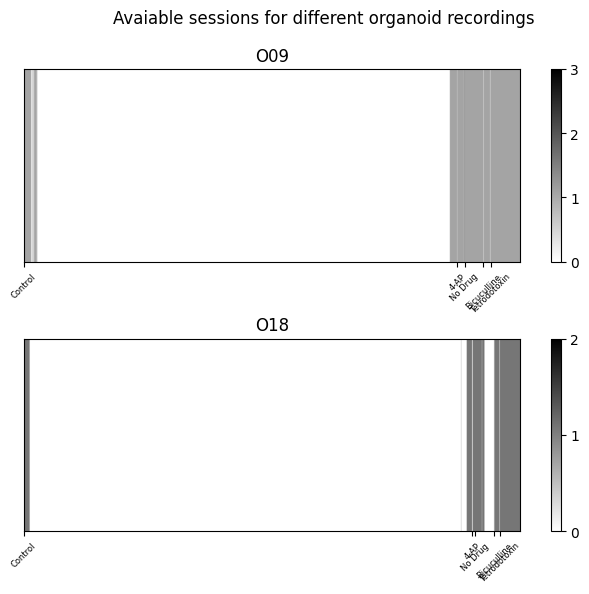

In [7]:
# Visualize Recordding Timeline

table = analysis.LFPSpectrogram.ChannelPower()
organoid_ids = np.unique((ephys.EphysSession & keys).fetch("organoid_id"))
N = len(organoid_ids)

fig, ax = plt.subplots(N, 1, figsize=(8,3*N))
fig.suptitle("Avaiable sessions for different organoid recordings")
fig.subplots_adjust(hspace=.4)

for i, organoid_id in enumerate(organoid_ids):

    if len(organoid_ids) == 1:
        ax = [ax]

    organoid_table = table & keys & f"organoid_id = '{organoid_id}'"
    experiment_info = np.array((culture.Experiment & f"organoid_id = '{organoid_id}'").fetch("drug_name", "experiment_start_time", "experiment_end_time"))

    # Get start and end points for recording timeline
    recording_start, recording_end = (np.min(experiment_info[1:,:]), np.max(experiment_info[1:,:]))
    data_times = np.array(organoid_table.fetch("start_time", "end_time")).transpose()

    # Remove repeat values
    unique_times = []
    for times in data_times:
        if not list(times) in unique_times:
            unique_times.append(list(times))
    unique_times = np.array(unique_times)

    # Plot Binary Colormap for times
    recording_times = np.arange(recording_start, recording_end, datetime.timedelta(minutes=1))
    has_data = np.zeros(recording_times.shape)
    for times in unique_times:
        has_data[(times[0]<=recording_times) & (recording_times<=times[1])] +=1

    date_num = mdates.date2num(recording_times)
    extent = [date_num[0], date_num[-1], 0, 1]

    a = ax[i].imshow(has_data[np.newaxis, :], extent=extent, aspect="auto", cmap="binary")
    cbar = plt.colorbar(a)
    cbar.set_ticks(np.arange(np.min(has_data), np.max(has_data)+1))

    ax[i].set_xticks([date_num[np.where(recording_times==drug_time)][0] for drug_time in experiment_info[1,:]])
    ax[i].set_xticklabels(experiment_info[0,:], rotation=45, fontsize=6)
    ax[i].set_yticks([])
    ax[i].set_title(organoid_id)

**_Step 3: Determine Time Periods for Analysis_**

- Given the long recording timeline, it would be wise to reduce our dataset for complex analysis procedures.
- To determine the best way to reduce the dataset, we'll use power of LFP bands and firing rate z-scores: 
    - x-axis: Time (First 6 hours of recording, 6 hours before drug treatments, drug treatments (~50 hours of data per orgaonoid))
    - y-axis: z-score for power or firing rate ((data_value - control_mean)/control_std)
    - colors: Frequency bands (Delta, Theta, Alpha, Beta, Gamma, HG1, HG2), Firing Rate (max between 5*std and 25uV)
- Plot settings
    - electrodes = (list) electrodes to be used in analysis ("all"=all electrodes, "inside"=all inside, "outside"=all outside)
    - average = (bool) average electrodes or plot individual electrodes


In [17]:
def get_num_elec_inside(organoid_id: str):

    elec_inside = {
        "O09": 32, "O10": 16, "O11": 20, "O12": 14,
        "O13": 25, "O14": 13, "O15": 11, "O16": 11,
        "O17": 22, "O18": 19, "O19": 20, "O20": 17,
        "O21": 18, "O22": 21, "O23": 22, "O24": 23,
        "O25": 20, "O26": 32, "O27": 26, "O28": 24,
            }
    return elec_inside[organoid_id]

In [46]:
# Load Data
organoid_ids, start_times, end_times, electrodes, band_names, power = (analysis.LFPSpectrogram.ChannelPower & keys).fetch("organoid_id", "start_time", "end_time", "electrode", "band_name", "mean_power")

In [47]:
# choose time bin
dt = 60 # min

# Make sure all time intevals are the same length
time_interval = end_times - start_times
if not np.all(time_interval == time_interval[0]):
    raise ValueError("All sessions need to have the same session time length")

ti_min = time_interval[0].total_seconds() / 60

# Make sure dt is a multiple of the sesssion time interval
if not (dt % ti_min) == 0:
    raise ValueError(f"Please choose a dt which is a multiple of the session length = {ti_min}")

In [48]:
# Get Data
data_dict = {}

for organoid_id in np.unique(organoid_ids):

    # Make a Figure per Organoid
    org_electrodes = np.arange(get_num_elec_inside(organoid_id))
    freq_bands = np.unique(band_names)
    freq_bands = freq_bands[[2, 6, 0, 1, 3, 4, 5]]

    organoid_bool = (organoid_ids==organoid_id)

    recording_timeline = np.arange(np.min(start_times[organoid_bool]), np.max(end_times[organoid_bool]), np.timedelta64(dt, 'm'))
    recording_timeline = recording_timeline[:-1] # remove last value 
    
    # extract data
    data_array = np.zeros((len(recording_timeline), len(freq_bands), len(org_electrodes)))
    for t, time in enumerate(recording_timeline):
        # define time window
        ts, tf = (time, time+np.timedelta64(dt, 'm'))
        time_bool = (ts <= start_times) & (start_times <= tf) # defining windows based on start times, this is an approximation because loading power series takes too long (mean power instead)

        # check if there's data in the time window -> fill in nan values and move to next iteration
        if not np.any(time_bool):
            data_array[t,:,:] = np.nan
            continue

        for b, band in enumerate(freq_bands):
            band_bool = (band_names == band)

            for e, elec in enumerate(org_electrodes):
                elec_bool = (electrodes == elec)

                # extract data
                data_bool = organoid_bool & time_bool & band_bool & elec_bool
                data_array[t, b, e] = np.mean(power[data_bool])
    data_dict[organoid_id] = (recording_timeline, data_array)


c:\Users\Organoid PC\anaconda3\envs\utah_organoids\lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\Organoid PC\anaconda3\envs\utah_organoids\lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [49]:
# Plot Settings
take_average = True
used_electrodes = [] # [] = all inside electrodes

lfp_colors = [
    "#ad2bea",
    "#4d3ff8",
    "#39cabb",
    "#53e53a",
    "#e3e12c",
    "#f7a740",
    "#ed3838",
]

[2025-06-23 21:04:46,248][WARNING]: MySQL server has gone away. Reconnecting to the server.
C:\Users\Organoid PC\AppData\Local\Temp\ipykernel_1720\1983889077.py:49: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale("log")
C:\Users\Organoid PC\AppData\Local\Temp\ipykernel_1720\1983889077.py:49: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale("log")
C:\Users\Organoid PC\AppData\Local\Temp\ipykernel_1720\1983889077.py:49: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale("log")
C:\Users\Organoid PC\AppData\Local\Temp\ipykernel_1720\1983889077.py:49: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale("log")
C:\Users\Organoid PC\AppData\Local\Temp\ipykernel_1720\1983889077.py:49: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale("log")
C:\Users\Organoid PC\AppData\Local\Tem

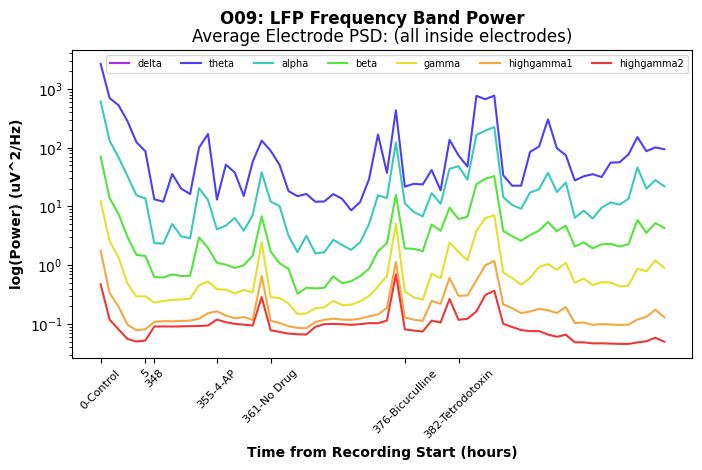

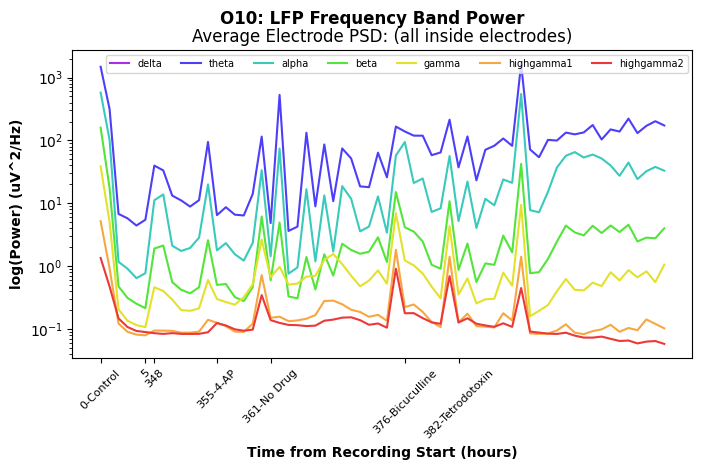

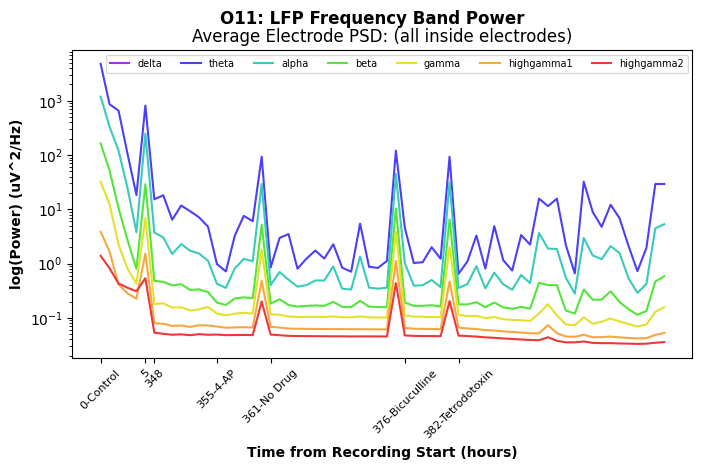

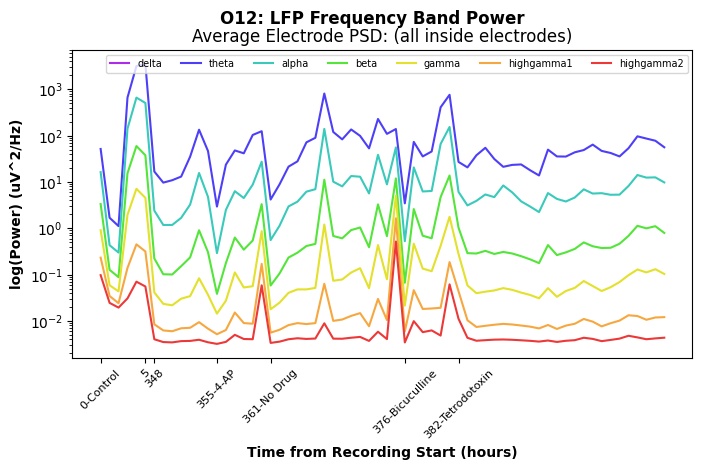

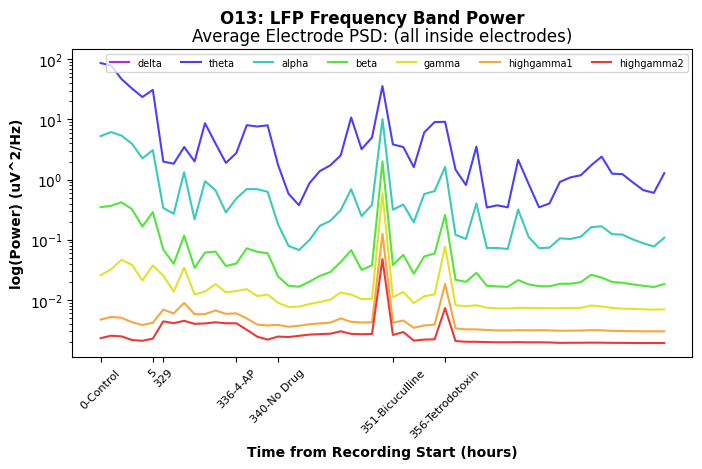

...

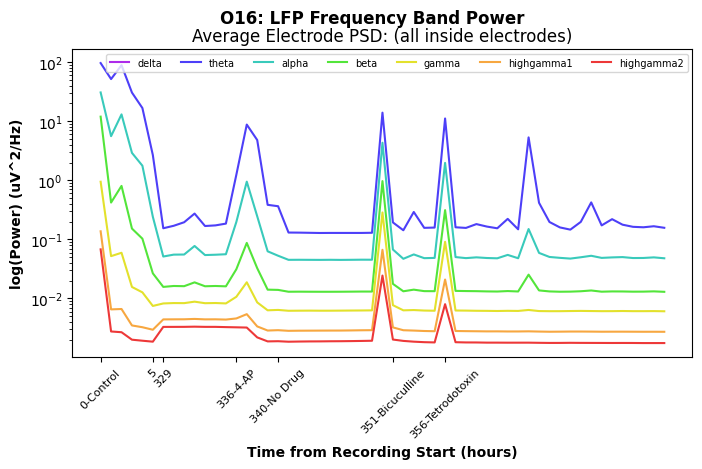

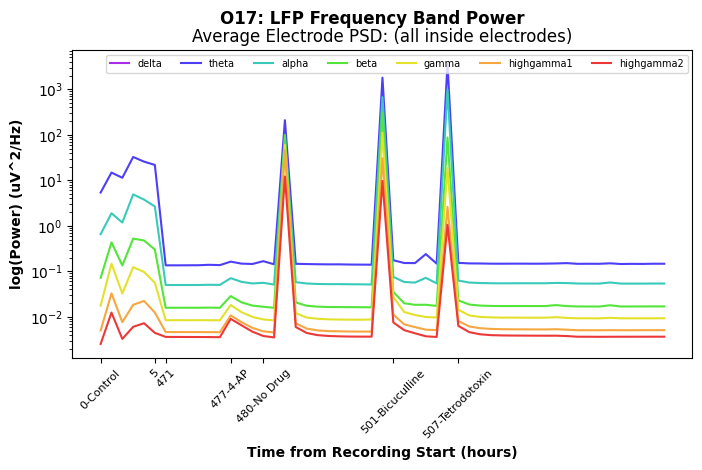

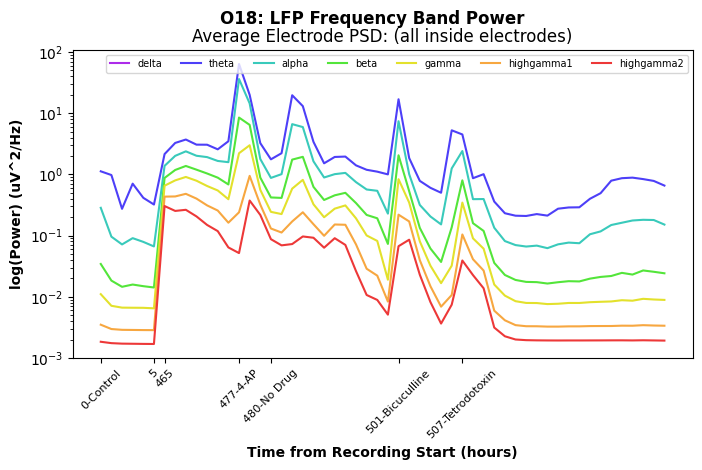

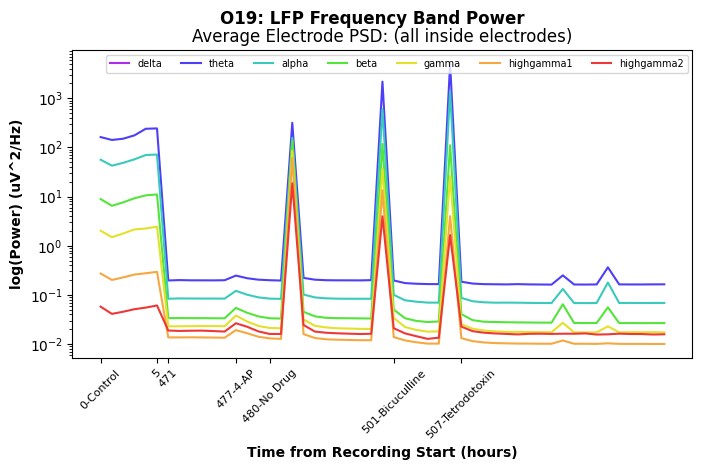

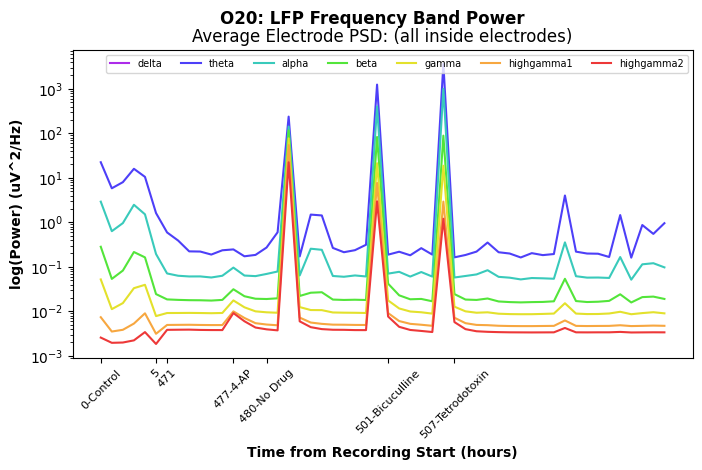

In [54]:
# Plot Data
for organoid_id, (recording_timeline, data_array_dict) in data_dict.items():
    data_array = data_array_dict.copy()

    if len(used_electrodes) > 0:
        data_array = data_array[:,:,used_electrodes]
        elec_str = used_electrodes
    else:
        elec_str = "all inside electrodes"

    if take_average:
        plot_array = np.mean(data_array, axis=2)[:,:,np.newaxis]
        average_str = "Average"
    else:
        average_str = "Individual"

    # Remove nan values from recording timeline and plot data
    recording_bool = ~np.isnan(plot_array[:,0,0])
    plot_array = plot_array[recording_bool,:,:]
    plot_time = recording_timeline[recording_bool]

    # X-ticks (label breaks in recording and drug treatments)
    x_ticks = []
    x_tick_labels = []

    recording_time_idx = np.where(recording_bool==True)[0]
    recording_breaks = np.where(np.diff(recording_time_idx) > 12)[0]
    for recording_break in recording_breaks:
        x_ticks.extend([recording_break, recording_break+1])
        x_tick_labels.extend([recording_time_idx[recording_break], recording_time_idx[recording_break+1]])

    drug_names, drug_times = (culture.Experiment & f"organoid_id = '{organoid_id}'").fetch("drug_name", "experiment_start_time")
    for d in range(len(drug_names)):
        didx = np.argmin(np.abs(plot_time - drug_times.astype(np.datetime64)[d]))
        x_ticks.extend([didx])
        x_tick_labels.extend([f"{recording_time_idx[didx]}-{drug_names[d]}"])


    N = plot_array.shape[2]
    fig, ax = plt.subplots(N, 1, figsize=(8,4*N))
    fig.suptitle(f"{organoid_id}: LFP Frequency Band Power", weight="bold")
    for i in range(N):
        if i > 0:
            ax = ax[i]

        for f in range(len(freq_bands)):
            
            ax.plot(plot_array[:,f,i], color=lfp_colors[f], label=freq_bands[f])
            ax.set_yscale("log")

        ax.set_title(f"{average_str} Electrode PSD: ({elec_str})")
        ax.set_ylabel("log(Power) (uV^2/Hz)", weight="bold")
        ax.set_xlabel("Time from Recording Start (hours)", weight="bold")
        if i == 0:
            ax.legend(loc="upper right", ncol=7, fontsize=7)
        ax.set_xticks(x_ticks)
        ax.set_xticklabels(x_tick_labels, fontsize=8, rotation=45)


Visualize changes in firing rate
z-score of firing rate with unique control/ std values
- For the z-score of dt(n) -> u and sigma will be from dt(n-1)
- Z scores with values more extreme than 2 (+ or =) will be marked and not included for the next z-score calculation
- ex: if day 3 has an extreme value, the mean and std of day 2 will be used to calculate the zscore for day 4

In [4]:
# Parameters
dt = 12 # hours
thresh = 2 # z-scores

def get_num_elec_inside(organoid_id: str):

    elec_inside = {
        "O09": 32, "O10": 16, "O11": 20, "O12": 14,
        "O13": 25, "O14": 13, "O15": 11, "O16": 11,
        "O17": 22, "O18": 19, "O19": 20, "O20": 17,
        "O21": 18, "O22": 21, "O23": 22, "O24": 23,
        "O25": 20, "O26": 32, "O27": 26, "O28": 24,
            }
    return elec_inside[organoid_id]

In [5]:
organoid_ids = np.unique(mua.MUASpikes().fetch("organoid_id"))

# for organoid id in organoid_ids:
organoid_id = "O09"
organoid_spikes = (mua.MUASpikes.Channel & f"organoid_id = '{organoid_id}'")

# Extract information from MUASpikes Table
start_time, channel_idx, spike_rate = organoid_spikes.fetch("start_time", "channel_idx", "spike_rate")
recording_start = (culture.Experiment & f"organoid_id = '{organoid_id}'" & "drug_name = 'Control'").fetch1("experiment_start_time")
recording_end = np.sort(start_time)[-1]

bins = np.arange(recording_start, recording_end, datetime.timedelta(hours=dt))
bins = bins[:-2] # bins = bin start times 

firing_rate_array = []
recording_ratio_list = []
# loop through time windows
for bin in bins:

    # find times for each window
    bin_bool = (bin <=start_time) & (start_time <= (bin+np.timedelta64(dt, 'h')))
    bin_times = np.unique(start_time[bin_bool])

    # extract necessary info (recording_ratio, firing rate (per channel))
    recording_ratio = len(bin_times) / dt*60 # num minutes of recording / total minutes in interval
    recording_ratio_list.append(recording_ratio)

    # loop thorugh electrodes to find firing rate
    bin_firing_rate = []
    electrodes = np.arange(get_num_elec_inside(organoid_id)) # number of electrodes inside organoid
    for electrode in electrodes:
        electrode_spikes = spike_rate[(bin_bool) & (channel_idx == electrode)] # filter by time window and electrode id
        bin_firing_rate.append(np.mean(electrode_spikes))
    
    firing_rate_array.append(bin_firing_rate)
firing_rate_array = np.array(firing_rate_array)
firing_rate_array = firing_rate_array[~np.isnan(firing_rate_array[:,0]), :]

16 periods have an abs(z-score) > 2


Text(0.5, 0, 'Time (hours)')

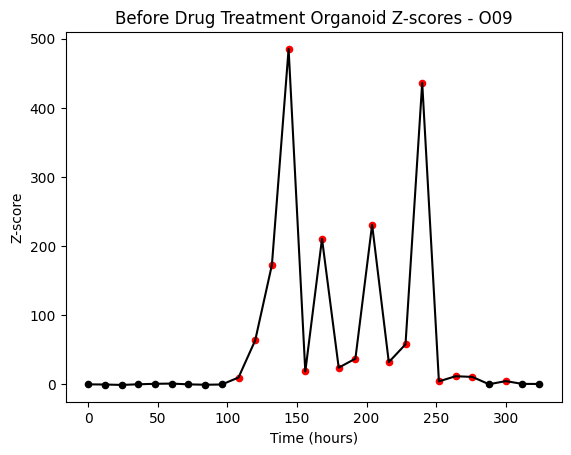

In [12]:
# Plot Moving Z-scores
N = firing_rate_array.shape[0]
fr_mean = np.mean(firing_rate_array, axis=1)
fr_std = np.std(firing_rate_array, axis=1)

z_list = []
for i in range(N):

    if i == 0:
        z = 0

    else:  
        # check if previous z scores exceed the threshold (won't use those values as a baseline)
        ref_idx = i-1
        while abs(z_list[ref_idx]) >= thresh:
            ref_idx -= 1
        
        z = (fr_mean[i] - fr_mean[ref_idx]) / fr_std[ref_idx]
    
    z_list.append(z)

z_list = np.array(z_list)
outlier_times = np.abs(z_list) > 2
print(f"{sum(outlier_times)} periods have an abs(z-score) > 2")
t = np.arange(0, dt*len(z_list), dt)

fig, ax1 = plt.subplots()
plt.title(f"Before Drug Treatment Organoid Z-scores - {organoid_id}")

ax1.plot(t, z_list, color='k', linestyle='-')
ax1.scatter(t[~outlier_times], z_list[~outlier_times], s=20, color='k')
ax1.scatter(t[outlier_times], z_list[outlier_times], s=20, color='r', label="abs(z)>2")

ax1.set_ylabel("Z-score")
ax1.set_xlabel("Time (hours)")

# xticks = []
# xticklabels = []
# drug_names, experiment_start_times = (culture.Experiment & f"organoid_id = '{organoid_id}'").fetch("drug_name", "experiment_start_time")
# for d in range(len(drug_names)):
#     rel_hr = experiment_start_times[d] - experiment_start_times[0]
#     rel_hr = rel_hr.total_seconds() / (60*60)

#     xticks.append(rel_hr)
#     xticklabels.append(f"{int(rel_hr)}-{drug_names[d]}")
# plt.xticks(xticks, labels=xticklabels, fontsize=6, rotation=45)
    
# Plot second axis with firing rate
# Investigate Peak at 10 hours


[2025-06-16 18:39:08,147][WARNING]: MySQL server has gone away. Reconnecting to the server.
C:\Users\Organoid PC\AppData\Local\Temp\ipykernel_8820\2041484277.py:21: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)



([<matplotlib.axis.XTick at 0x202fe5f8cd0>,
 [Text(0, 0, '0'), Text(702, 0, '702')])

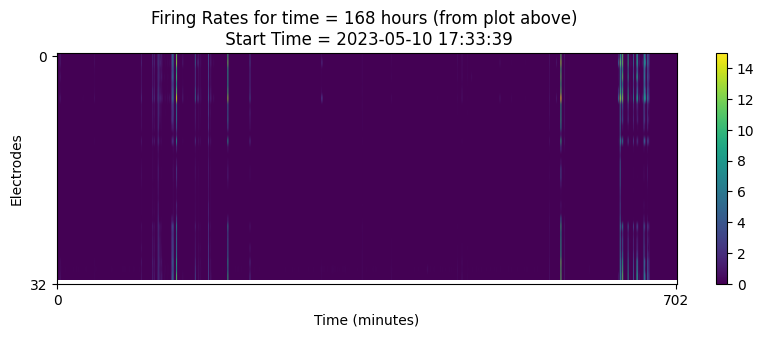

In [20]:
# Investigate Peak at 10 hours
idx = np.argmax(z_list) + 2

idx_time = bins[idx]
time_spikes = organoid_spikes & f"start_time BETWEEN '{idx_time}' AND '{idx_time+np.timedelta64(dt, 'h')}'"

# Extract information from MUASpikes Table
start_time, channel_idx, spike_rate = time_spikes.fetch("start_time", "channel_idx", "spike_rate")

times = np.unique(start_time)
N = len(times)
num_elec = get_num_elec_inside(organoid_id)

firing_rate_plot = np.empty((num_elec, N))

# loop through times and electrodes
for t, time in enumerate(times):
    for elec in range(num_elec):
        
        firing_rate = spike_rate[(start_time == time) & (channel_idx == elec)]
        firing_rate_plot[elec, t] = firing_rate

plt.figure(figsize = (10,3))
plt.imshow(firing_rate_plot, aspect="auto")
plt.colorbar()

plt.title(f"Firing Rates for time = {idx*dt} hours (from plot above) \n Start Time = {times[0]}")
plt.ylabel("Electrodes")
plt.xlabel("Time (minutes)")
plt.yticks([0, num_elec])
plt.xticks([0, t])



In [19]:
# Investigate the maximum value 
max_idx = np.argmax(firing_rate_plot)
max_channel, max_time_idx = np.unravel_index(max_idx, firing_rate_plot.shape)
max_time = times[max_time_idx]

print(max_channel, max_time_idx, firing_rate_plot[max_channel, max_time_idx])
trace_key = (mua.MUATracePlot.Channel & f"channel_idx = '{max_channel}'" & f"start_time = '{max_time}'").fetch1("KEY")

trace_plot = (mua.MUATracePlot.Channel & trace_key).fetch1("trace_plot")

fig = pio.from_json(trace_plot)
fig.show()

[2025-06-16 18:33:59,917][WARNING]: MySQL server has gone away. Reconnecting to the server.


30 174 43.9


In [252]:
k = (mua.MUATracePlot.Channel & "organoid_id = 'O09'").fetch("KEY")
len(k)

[2025-06-16 17:44:22,880][WARNING]: MySQL server has gone away. Reconnecting to the server.


3079

In [259]:
k1 = (mua.MUATracePlot.Channel & "organoid_id = 'O09'" & f"start_time = '{max_time}'" & f"channel_idx = '{max_channel}'").fetch1("KEY")
a = (mua.MUATracePlot.Channel & k1).fetch1("trace_plot")
fig = pio.from_json(a)
fig.show()

[2025-06-16 17:51:11,921][WARNING]: MySQL server has gone away. Reconnecting to the server.


Copying "Function neuronal circuitry and oscillatory dynamics in human brain organoids" population activity methods
- Procedure
    - Get population spike vector
        - pool spike times across all electrodes
        - create firing rate vector with 1 ms bins
        - apply 20 ms average window filter
        - apply 100 ms gausian kernal filter
    - Find bursts
        - threshold at 2x population spike vector rms value
        - extract peak amplitude, peak time, peak window (period which is 90% of peak)
- Current problems
    - MUA spike detection refractory period. Ours is 2 ms which doesn't really make sense for multiunit spikes. 


In [4]:
organoid_id = "O09"
fs = 20000

# load mua data
experiment_start_times, start_times, channel_idxs, spike_indices = (mua.MUASpikes.Channel() & f"organoid_id = '{organoid_id}'").fetch("experiment_start_time", "start_time", "channel_idx", "spike_indices")


In [5]:
# Get spike times 
experiment_start_time = np.unique(experiment_start_times)[0]
experiment_bool = experiment_start_times == experiment_start_time

spike_times_array = np.array([], dtype='datetime64[ms]')
for start_time in np.unique(start_times[experiment_bool]):
    time_bool = start_times == start_time

    # extract spike data for start time
    time_data = spike_indices[experiment_bool & time_bool] # uneven 2D array of spike indices
    spike_list = [spike_idx for chan_data in time_data for spike_idx in chan_data] # flatten to list 
    spike_times = np.array([np.datetime64(start_time) + np.timedelta64(np.int64(spike_idx/fs*1e3), 'ms') for spike_idx in spike_list], dtype='datetime64[ms]') # spike_idx -> datetime (rounds to lower ms value)

    spike_times_array = np.concatenate([spike_times_array, spike_times])
print(f"{len(spike_times_array)} spikes found in {len(np.unique(start_times[experiment_bool]))} minutes of recording")


1148709 spikes found in 20731 minutes of recording


In [6]:
from scipy.ndimage import gaussian_filter1d

In [ ]:
# process spike times
spike_ms_array = (spike_times_array - np.datetime64(experiment_start_time)).astype('timedelta64[ms]').astype(int) # int array of # of ms since experiment start time (per spike detected)

# calculate firing rate vector (1 ms bins)
firing_rate1 = np.zeros((int((np.max(start_times[experiment_bool])+datetime.timedelta(minutes=1) - experiment_start_time).total_seconds() * 1e3),)) # total number of ms from experiment start time -> end of final file

for spike in spike_ms_array:
    firing_rate1[spike] += 1 # for each spike index add 1 
firing_rate1 = firing_rate1 / 1e-3 # num spikes -> firing rate

# apply 20 ms boxcar filter
ws_boxcar = int(20/1e3 * fs)
boxcar_kernel = np.ones(ws_boxcar) / ws_boxcar
firing_rate2 = np.convolve(firing_rate1, boxcar_kernel, mode="same")

# apply 100 ms gausian filter
ws_gaussian = int(100/1e3 * fs)
sigma = int(ws_gaussian/8)  # for 100 ms at 20 kHz
truncate = 4.0
radius = int(truncate * sigma)
x = np.arange(-radius, radius + 1)
kernel = np.exp(-0.5 * (x / sigma) ** 2)
kernel /= kernel.sum()

firing_rate3 = gaussian_filter1d(firing_rate2, sigma=int(ws_gaussian/8), mode="reflect")
# can also use gaussian_filter1d but it takes too long

(0.0, 50.0)

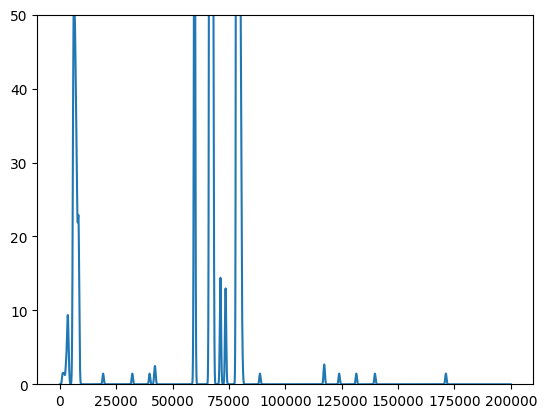

In [ ]:
# find burst amplitude, times, and windows

population_firing_vector = firing_rate3


In [29]:
25000 / 1000

25.0